# Analisis Data Airbnb New York City

by

### Rizal Farhan Nanda (3.34.23.3.20) & Rizqi Aditya Pratama (3.34.23.3.21)

## Introduction

Notebook ini merupakan bagian dari tugas **Ujian Tengah Semester (UTS)** untuk mata kuliah *Kecerdasan Buatan*.  

Analisis ini menggunakan dataset **Airbnb**, yang berisi informasi mengenai properti sewaan jangka pendek di wilayah New York, termasuk data lokasi, harga, jenis kamar, dan wilayah administratif.

Tujuan dari analisis ini adalah untuk:
- Memahami persebaran properti Airbnb berdasarkan lokasi.
- Menganalisis tren harga sewa pada berbagai wilayah.
- Menggambarkan karakteristik umum listing Airbnb di New York City.

## Import library

In [2]:
# Import library numpy sebagai np, digunakan untuk operasi numerik seperti array, aljabar linear, dan statistik
import numpy as np

# Import library pandas sebagai pd, digunakan untuk manipulasi dan analisis data dalam bentuk tabel (DataFrame)
import pandas as pd

# Import library matplotlib (inti) dan modul pyplot sebagai plt, digunakan untuk membuat grafik statis seperti line plot, bar chart, dll
import matplotlib
import matplotlib.pyplot as plt

# Import library seaborn sebagai sns, digunakan untuk visualisasi statistik yang lebih menarik dan informatif, berbasis matplotlib
import seaborn as sns

# Import modul plotly.express sebagai px, digunakan untuk membuat visualisasi data interaktif dengan sintaks yang sederhana
import plotly.express as px

## Load and Explore the Data

In [3]:
df_airbnb = pd.read_csv('./airbnb.csv')
df_airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [18]:
# menampilkan informasi dasar dataset
df_airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [19]:
df_airbnb.shape

(48895, 16)

In [21]:
# menampilkan data statistik dataset
df_airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [22]:
# cek missing values
df_airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [23]:
# Cek baris yang duplikat
df_airbnb.duplicated()

0        False
1        False
2        False
3        False
4        False
         ...  
48890    False
48891    False
48892    False
48893    False
48894    False
Length: 48895, dtype: bool

## Data Cleaning and Preprocessing

### Handle Missing Values

In [17]:
# Mengisi kolom 'name' dan 'host_name' yang hilang dengan 'Unknown'
df_airbnb['name'] = df_airbnb['name'].fillna('Unknown')
df_airbnb['host_name'] = df_airbnb['host_name'].fillna('Unknown')

# Mengisi 'reviews_per_month' dengan 0, karena tidak ada review
df_airbnb['reviews_per_month'] = df_airbnb['reviews_per_month'].fillna(0)

# Menghapus baris yang hilang pada kolom 'last_review'
df_airbnb = df_airbnb.dropna(subset=['last_review'])

In [18]:
# cek missing values
df_airbnb.isnull().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

## Exploratory Data Analysis

## Persebaran Lokasi Properti Airbnb

In [24]:
df_airbnb['neighbourhood_group'].value_counts(ascending=False)

neighbourhood_group
Manhattan        16632
Brooklyn         16447
Queens            4574
Bronx              876
Staten Island      314
Name: count, dtype: int64

### Diagram Batang Jumlah Listing Airbnb per Neighborhood Group

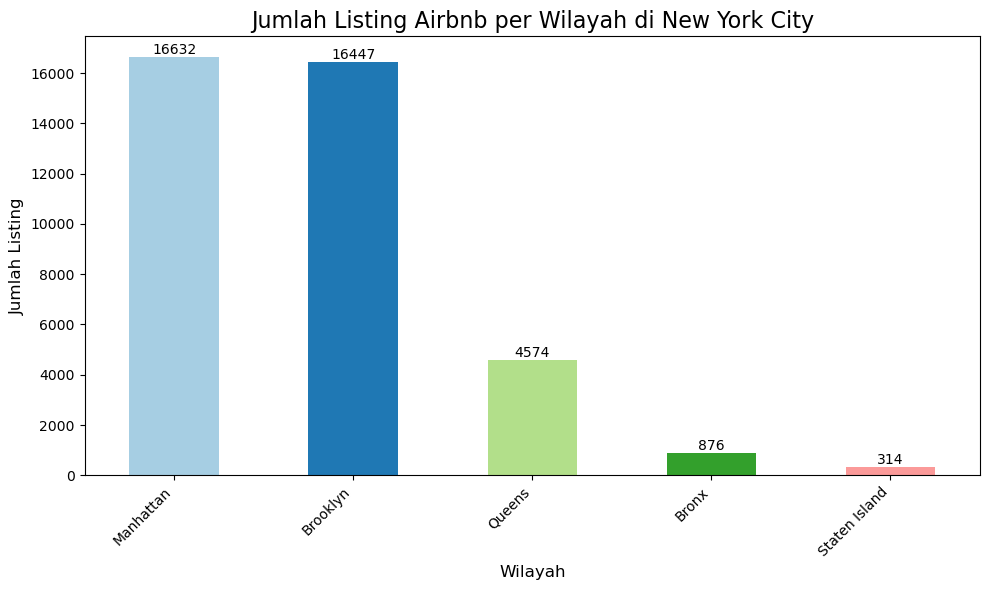

In [42]:
# Hitung jumlah listing per neighbourhood_group
neighbourhood_counts = df_airbnb['neighbourhood_group'].value_counts()

# Membuat diagram batang dengan warna berbeda
plt.figure(figsize=(10, 6))  # Menentukan ukuran plot
neighbourhood_counts.plot(kind='bar', color=plt.cm.Paired(range(len(neighbourhood_counts))))  # Menggunakan colormap 'Paired'

# Menambahkan judul dan label
plt.title("Jumlah Listing Airbnb per Wilayah di New York City", fontsize=16)
plt.xlabel("Wilayah", fontsize=12)
plt.ylabel("Jumlah Listing", fontsize=12)

# Menambahkan label pada setiap batang
for i, count in enumerate(neighbourhood_counts):
    plt.text(i, count + 10, str(count), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')  # Rotasi label sumbu X agar lebih mudah dibaca
plt.tight_layout()  # Agar layout tidak terpotong
plt.show()

### Penyebaran Lokasi Properti Airbnb di New York Berdasarkan Neighborhood

Peta di bawah ini menunjukkan penyebaran geografis daftar Airbnb di kota New York

In [11]:
fig = px.scatter_map(
    df_airbnb,  # DataFrame yang digunakan
    lat="latitude",  # Kolom latitude
    lon="longitude",  # Kolom longitude
    color="neighbourhood_group",  # Pewarnaan berdasarkan wilayah
    hover_name="name",  # Nama listing tampil saat hover
    hover_data={"price": True, "room_type": True, "latitude": False, "longitude": False},  # Info tambahan
    zoom=9,  # Level zoom awal
    center={"lat": 40.7128, "lon": -74.0060},  # Pusat peta (New York City)
    opacity=0.6,  # Transparansi marker
    height=800,  # Tinggi peta
    width=1000,  # Lebar peta
)

# Style
fig.update_layout(mapbox_style="open-street-map")

# Tampilkan peta
fig.show()

## Analisis Tipe Kamar, Malam Minimum, dan Ketersediaan

### Room Type Analysis

In [38]:
df_airbnb['room_type'].value_counts(ascending=False)

room_type
Entire home/apt    20332
Private room       17665
Shared room          846
Name: count, dtype: int64

#### Jumlah Listing per Room Type di Airbnb

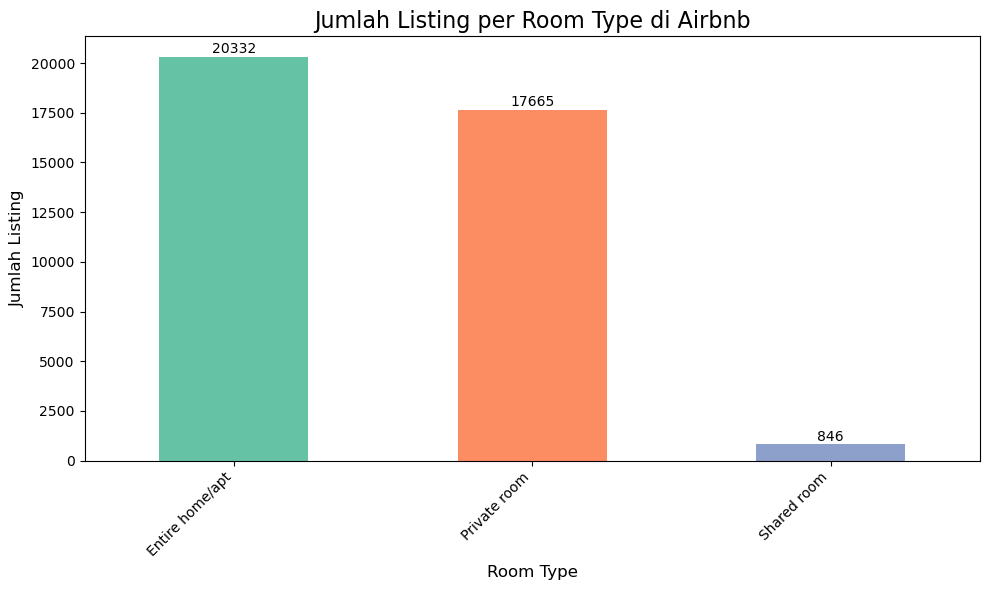

In [43]:
# Hitung jumlah listing per room_type
room_type_counts = df_airbnb['room_type'].value_counts(ascending=False)

# Membuat diagram batang dengan warna berbeda
colors = plt.cm.Set2(range(len(room_type_counts)))  # Warna berbeda untuk setiap batang

plt.figure(figsize=(10, 6))  # Menentukan ukuran plot
room_type_counts.plot(kind='bar', color=colors)  # Plot batang dengan warna berbeda

# Menambahkan judul dan label
plt.title('Jumlah Listing per Room Type di Airbnb', fontsize=16)
plt.xlabel('Room Type', fontsize=12)
plt.ylabel('Jumlah Listing', fontsize=12)

# Menambahkan label pada setiap batang
for i, count in enumerate(room_type_counts):
    plt.text(i, count + 10, str(count), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')  # Rotasi label sumbu X agar lebih mudah dibaca
plt.tight_layout()  # Agar layout tidak terpotong
plt.show()

#### Rata-rata Ketersediaan Bedarsarkan Room Type

In [45]:
# Menghitung ketersediaan rata-rata berdasarkan Room Type
average_avail=df_airbnb.groupby('neighbourhood_group')['availability_365'].mean().sort_values(ascending=False).round(2).reset_index()
average_avail

,neighbourhood_group,availability_365
0,Staten Island,205.64
1,Bronx,170.94
2,Queens,150.51
3,Manhattan,109.32
4,Brooklyn,105.88


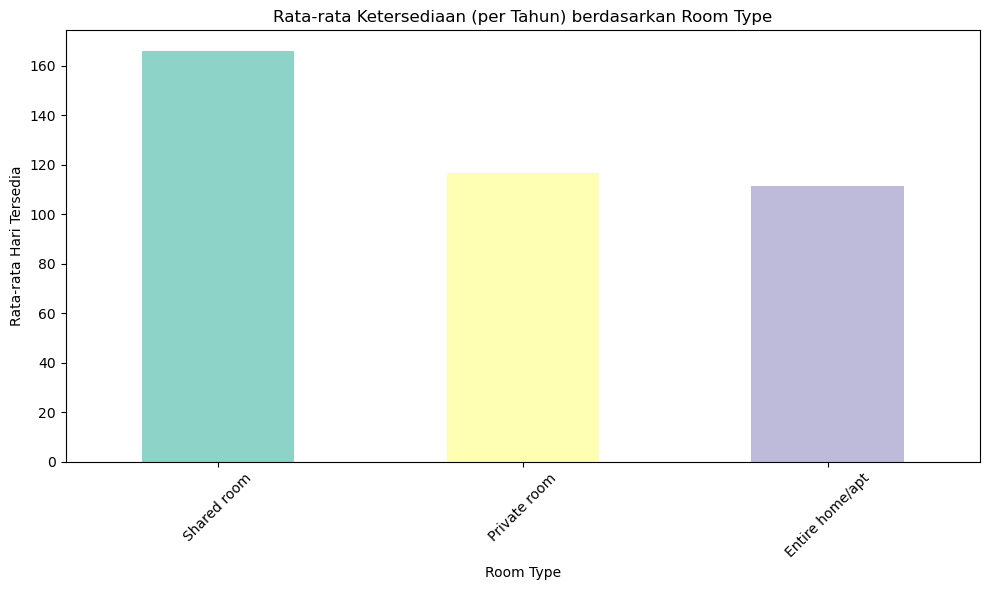

In [47]:
availability_by_type = df_airbnb.groupby('room_type')['availability_365'].mean().sort_values(ascending=False)

# Plot
plt.figure(figsize=(10, 6))
availability_by_type.plot(kind='bar', color=plt.cm.Set3(range(len(availability_by_type))))
plt.title('Rata-rata Ketersediaan (per Tahun) berdasarkan Room Type')
plt.xlabel('Room Type')
plt.ylabel('Rata-rata Hari Tersedia')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#### Jumlah Listing per Room Type dan Neighbourhood Group

In [49]:
# Hitung jumlah listing per room_type dan wilayah
room_demand = df_airbnb.groupby(['neighbourhood_group', 'room_type']).size().unstack().fillna(0)
room_demand

room_type,Entire home/apt,Private room,Shared room
neighbourhood_group,,,
Bronx,309,524,43
Brooklyn,8164,7993,290
Manhattan,9967,6309,356
Queens,1742,2680,152
Staten Island,150,159,5


In [55]:
import plotly.express as px

# Hitung jumlah listing per kombinasi wilayah dan room_type
room_demand_long = df_airbnb.groupby(['neighbourhood_group', 'room_type']).size().reset_index(name='count')

# Buat diagram batang terpisah (grouped bar)
fig = px.bar(
    room_demand_long,
    x='neighbourhood_group',      # Sumbu X: wilayah
    y='count',                    # Sumbu Y: jumlah listing
    color='room_type',            # Warna berdasarkan tipe kamar
    title='Jumlah Listing Airbnb per Room Type dan Wilayah di New York City',
    labels={
        'neighbourhood_group': 'Wilayah',
        'count': 'Jumlah Listing',
        'room_type': 'Tipe Kamar'
    },
    barmode='group',              # Batang dipisah berdasarkan tipe kamar
    height=600
)

# Tampilkan grafik
fig.show()

### Minimum Nights Analysis

In [56]:
df_airbnb['minimum_nights'].describe()

count    38843.000000
mean         5.868059
std         17.384784
min          1.000000
25%          1.000000
50%          2.000000
75%          4.000000
max       1250.000000
Name: minimum_nights, dtype: float64

#### Rata-rata Jumlah Malam Minimum Berdasarkan Room Type dan Neighbourhood Group

In [68]:
average_minimum_nights=df_airbnb.groupby(["neighbourhood_group", "room_type"])['minimum_nights'].mean().reset_index().sort_values('minimum_nights',ascending=False).round(2)
average_minimum_nights

,neighbourhood_group,room_type,minimum_nights
6,Manhattan,Entire home/apt,8.61
5,Brooklyn,Shared room,6.23
3,Brooklyn,Entire home/apt,5.91
0,Bronx,Entire home/apt,5.64
4,Brooklyn,Private room,4.69
7,Manhattan,Private room,4.69
9,Queens,Entire home/apt,4.37
10,Queens,Private room,4.13
11,Queens,Shared room,4.09
12,Staten Island,Entire home/apt,3.87


In [5]:
# Misalkan df_airbnb adalah DataFrame yang sudah ada dan berisi data
average_minimum_nights = df_airbnb.groupby(["neighbourhood_group", "room_type"])['minimum_nights'].mean().reset_index().sort_values('minimum_nights',ascending=False).round(2)

# Membuat diagram batang menggunakan Plotly
fig = px.bar(average_minimum_nights,
             x='neighbourhood_group',
             y='minimum_nights',
             color='room_type',
             barmode='group',
             title="Rata-rata Jumlah Malam Minimum berdasarkan Room Type dan Neighbourhood Group",
             labels={'minimum_nights': 'Rata-rata Minimum Nights', 'neighbourhood_group': 'Neighbourhood Group'},
             color_discrete_sequence=px.colors.qualitative.Set2)

# Menampilkan diagram
fig.update_layout(xaxis_title='Neighbourhood Group', yaxis_title='Rata-rata Minimum Nights', xaxis_tickangle=45)
fig.show()

## Analisis Harga dan Rating Listing Airbnb

In [71]:
# Tampilkan statistik deskriptif harga
price_stats = df_airbnb['price'].describe()

# Menampilkan tabel
price_stats

count    38843.000000
mean       142.317947
std        196.945624
min          0.000000
25%         69.000000
50%        101.000000
75%        170.000000
max      10000.000000
Name: price, dtype: float64

#### Rata-rata Harga per Room Type

In [80]:
# Menghitung rata-rata harga per room_type
average_price_per_room_type = df_airbnb.groupby('room_type')['price'].mean().sort_values(ascending=False).round(2)

# Menampilkan tabel
average_price_per_room_type

room_type
Entire home/apt    196.29
Private room        83.98
Shared room         63.21
Name: price, dtype: float64

C:\Users\rizqi\AppData\Local\Temp\ipykernel_32740\225097526.py:5: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



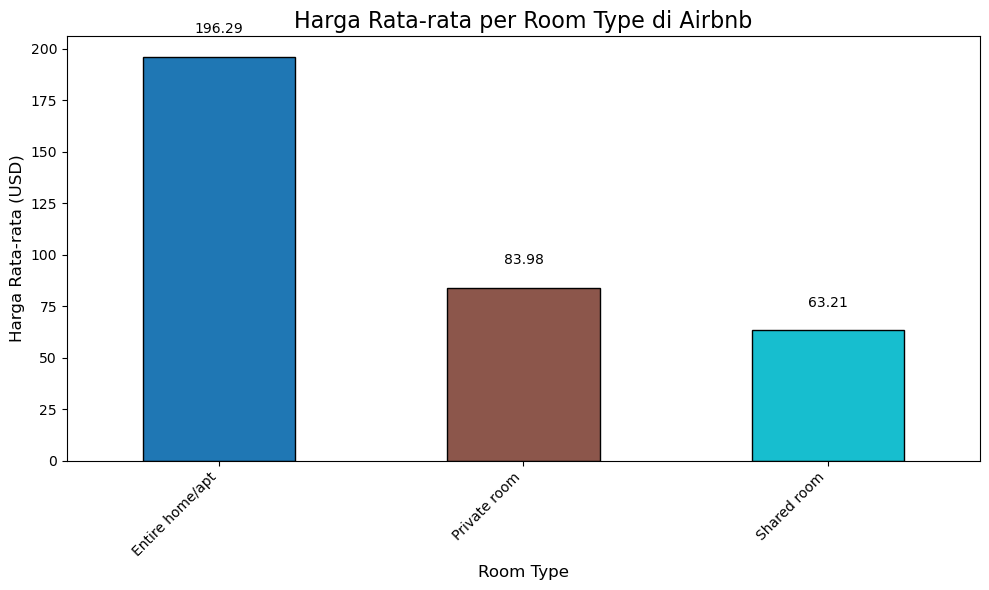

In [92]:
# Membuat diagram batang untuk harga rata-rata per room_type
plt.figure(figsize=(10, 6))

# Pilih palet warna untuk setiap kategori room_type
colors = plt.cm.get_cmap('tab10', len(average_price_per_room_type))

# Plot batang dengan warna berbeda untuk setiap room_type
average_price_per_room_type.plot(kind='bar', color=colors(range(len(average_price_per_room_type))), edgecolor='black')

# Menambahkan judul dan label
plt.title('Harga Rata-rata per Room Type di Airbnb', fontsize=16)
plt.xlabel('Room Type', fontsize=12)
plt.ylabel('Harga Rata-rata (USD)', fontsize=12)

# Menambahkan label pada setiap batang
for i, value in enumerate(average_price_per_room_type):
    plt.text(i, value + 10, str(value), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Relasi antara Harga dan Jumlah Ulasan pada Listing Airbnb

Plot di bawah ini menunjukkan hubungan antara **harga listing Airbnb** dan **jumlah ulasan** yang diterima oleh masing-masing listing. Setiap titik merepresentasikan satu properti.

Dari visualisasi ini, dapat diamati bahwa:
- Sebagian besar listing dengan **harga rendah hingga menengah** cenderung memiliki **jumlah ulasan lebih banyak**.
- Sebaliknya, **listing dengan harga sangat tinggi** umumnya memiliki **ulasan yang lebih sedikit**, yang mungkin disebabkan oleh lebih rendahnya jumlah penyewa.

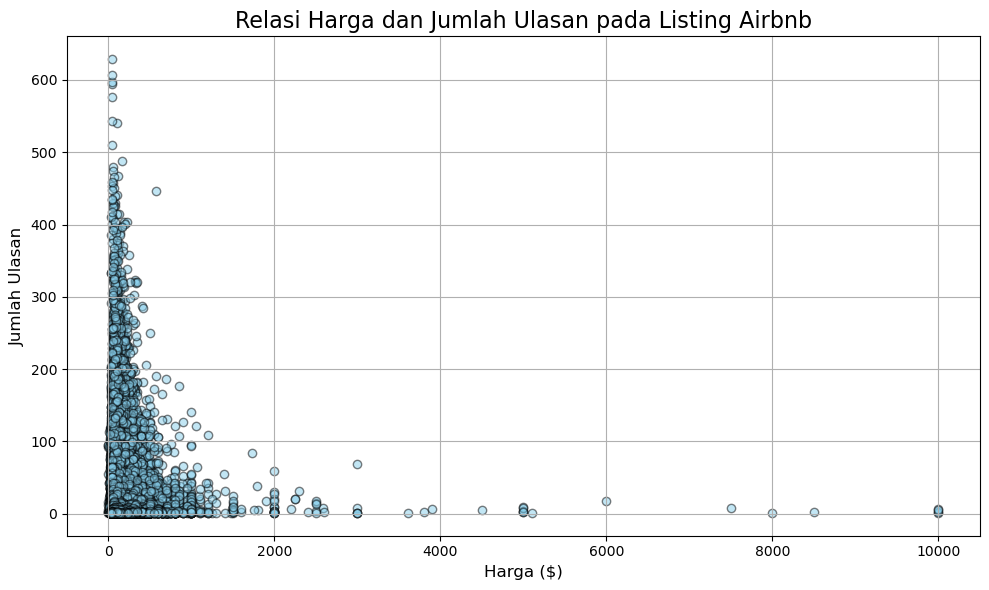

In [94]:
plt.figure(figsize=(10, 6))
plt.scatter(df_airbnb['price'], df_airbnb['number_of_reviews'], alpha=0.5, color='skyblue', edgecolor='black')

plt.title('Relasi Harga dan Jumlah Ulasan pada Listing Airbnb', fontsize=16)
plt.xlabel('Harga ($)', fontsize=12)
plt.ylabel('Jumlah Ulasan', fontsize=12)

plt.grid(True)
plt.tight_layout()
plt.show()

#### rata-rata harga per neighbourhood_group

In [9]:
# Hitung rata-rata harga per neighbourhood_group
neighbourhood_avg_price = df_airbnb.groupby('neighbourhood_group')['price'].mean().round(2)

# Menampilkan tabel harga rata-rata per neighbourhood_group
neighbourhood_avg_price

neighbourhood_group
Bronx             87.50
Brooklyn         124.38
Manhattan        196.88
Queens            99.52
Staten Island    114.81
Name: price, dtype: float64

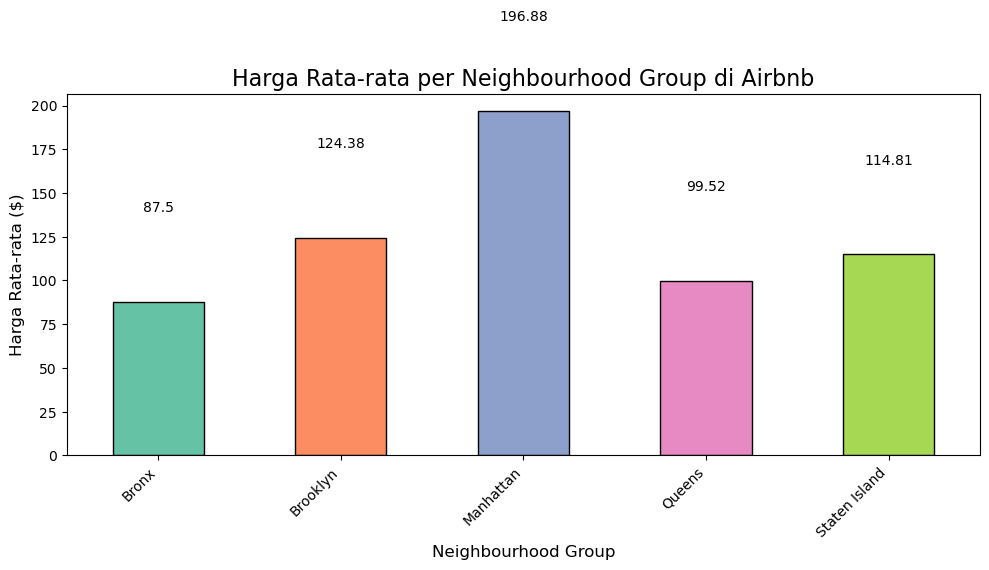

In [10]:
# Membuat diagram batang harga rata-rata per neighbourhood_group
plt.figure(figsize=(10, 6))

# Mengambil colormap agar warna batang berbeda
colors = plt.cm.Set2(range(len(neighbourhood_avg_price)))

neighbourhood_avg_price.plot(kind='bar', color=colors, edgecolor='black')

# Menambahkan judul dan label
plt.title('Harga Rata-rata per Neighbourhood Group di Airbnb', fontsize=16)
plt.xlabel('Neighbourhood Group', fontsize=12)
plt.ylabel('Harga Rata-rata ($)', fontsize=12)

# Menambahkan label pada setiap batang
for i, value in enumerate(neighbourhood_avg_price):
    plt.text(i, value + 50, round(value, 2), ha='center', va='bottom', fontsize=10)

# Menampilkan plot
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()